<a href="https://colab.research.google.com/github/DhanushAnegondi/End-to-End-ML_Models/blob/main/vector_embeddings.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Multiclass Classification :

---

## Problem Statement:


The dataset for this problem might seem peculiar in the first look, but this is how LLM's actually see and use the data. LLM's are based on the concept of vector embeddings which tries to capture the semantic relation between in the words in a sentence.

**What are Vector embeddings ?**

- Vector embeddings are numerical representations that capture the relationships and meaning of words, phrases and other data types. Through vector embeddings, essential characteristics or features of an object are translated into a concise and organized array of numbers, helping computers rapidly retrieve information.

For instance,
- Notice how the distance between vector embeddings of 'King' and 'Man' is similar to the distance between that of 'Queen' and 'Woman'.
- Similarly, the distance between between vector embeddings of 'King' and 'Queen' is similar to that of 'Man' and 'Woman', implying a similar relation between both.

<p align="center">
  <img src="https://www.researchgate.net/profile/Peter-Sutor/publication/332679657/figure/fig1/AS:809485488640000@1570007788866/The-classical-king-woman-man-queen-example-of-neural-word-embeddings-in-2D-It.png" />
</p>



**How does this work?**
- For any query or a 'prompt' that a user enters, they are first converted into these vector embeddings and after feature engineering in a certain way, metrics, such as *'cosine similarity'* scores are used to retrieve information that are most closely related to the given 'prompt'.
- Every LLM, i.e Google's BERT, Open AI's Chat GPT, uses a different model to convert sentences/documents into vector embeddings.
- This is exactly how search engines such as "Google" work as well.


---

## Dataset Description :

The dataset below contains the vector embeddings of 54,000 rows which have been put into 10 classes.
The objective is to develop a predictive model that can accurately take a set of vector embeddings as input and put them into a given class.

## Aim:
* To perform multi-class classification on the listed vector embeddings.

## Dataset Attributes
Here is a brief overview of the dataset columns:

| Column Name | Description |
| --- | --- |
| **Content** | A NumPy array of floating point numbers that contain the vector embeddings of a given sentence   |
| **Class**   | The numerical classes that each of the sentence were separated into based on the content in them |


---
## Load the dataset :

In [ ]:
import pickle
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_validate
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV, learning_curve
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
from sklearn.cluster import KMeans

import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_pickle('/Users/dhanushchandra/Desktop/final/Problem3/data/train.pkl', compression = 'gzip')


---

## Data Analysis

- Summarize the data. How much data is present? What is the shape of the dataset? What is the shape of each row?

- Convert the array of values into columns such that each value of the array represents a 'feature' of the sentence. This should leave you with a dataset with 384 columns with features and 1 column with the target variable.

- Try to Analyze and discuss the relationships between the attributes.

- Use appropriate visualization techniques to visualize the features.

In [ ]:
%%time

df.shape

CPU times: user 32 µs, sys: 1 µs, total: 33 µs
Wall time: 43.2 µs


(54000, 385)

In [ ]:
df.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_375,feature_376,feature_377,feature_378,feature_379,feature_380,feature_381,feature_382,feature_383,target
20219,-0.441182,0.039758,-0.096716,-0.325088,-0.281903,0.396630,0.479592,0.022123,0.037306,0.100461,...,0.090767,0.132293,-0.072522,-0.489568,0.183016,-0.075469,-0.304630,0.639570,0.244022,10
10100,0.005069,0.062893,0.332654,-0.268345,0.351607,0.179265,1.085914,0.137451,-0.215401,-0.238715,...,-0.470249,-0.016706,-0.171675,0.025053,0.345940,-0.380571,-0.011566,0.182901,0.450810,7
6202,-0.238280,0.062563,0.580820,-0.308987,0.168390,0.464604,0.770424,0.408037,-0.604461,-0.245012,...,-0.651022,-0.129468,0.136676,0.012791,-0.058777,-0.583225,-0.848802,0.374475,0.141444,8
6248,0.191293,0.693149,0.100221,-0.074036,0.283898,0.199221,0.677960,0.240535,0.181713,-0.235484,...,-0.074472,-0.355305,-0.327696,-0.150666,0.329692,-0.162642,-0.361339,0.279542,0.182272,1
20758,-0.038615,0.102616,0.350334,-0.167825,0.520621,0.019089,0.123427,0.810578,0.121413,-0.159571,...,-0.437117,-0.680356,-0.446885,-0.179272,-0.119086,-0.672074,-0.017897,0.165097,0.082835,6


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 54000 entries, 20219 to 23720
Columns: 385 entries, feature_0 to target
dtypes: float32(384), int64(1)
memory usage: 79.9 MB


In [ ]:
print("Shape of the dataset:", df.shape)

row_shape = df.drop(columns=['target']).shape[1]
print("Shape of each row (excluding the target column):", row_shape)

Shape of the dataset: (54000, 385)
Shape of each row (excluding the target column): 384
CPU times: user 20.1 ms, sys: 17.2 ms, total: 37.3 ms
Wall time: 37.2 ms


In [ ]:
%%time

features_df = df['feature_0'].apply(pd.Series)
features_df.columns = [f'feature_{i}' for i in range(features_df.shape[1])]

processed_df = pd.concat([features_df, df['target']], axis=1)

print(processed_df.head())

       feature_0  target
20219  -0.441182      10
10100   0.005069       7
6202   -0.238280       8
6248    0.191293       1
20758  -0.038615       6
CPU times: user 6.97 s, sys: 181 ms, total: 7.15 s
Wall time: 7.17 s


In [ ]:
%%time

correlation_matrix = df.corr()
print(correlation_matrix)

             feature_0  feature_1  feature_2  feature_3  feature_4  feature_5  \
feature_0     1.000000   0.101298  -0.028905   0.001190   0.045214   0.004380   
feature_1     0.101298   1.000000  -0.081215  -0.040676  -0.007938   0.000783   
feature_2    -0.028905  -0.081215   1.000000   0.034490  -0.031665  -0.059725   
feature_3     0.001190  -0.040676   0.034490   1.000000   0.024215  -0.015235   
feature_4     0.045214  -0.007938  -0.031665   0.024215   1.000000   0.028580   
...                ...        ...        ...        ...        ...        ...   
feature_380   0.070608   0.117754  -0.105141  -0.065420   0.024262  -0.054110   
feature_381  -0.173797  -0.012418  -0.090392  -0.122848  -0.146515  -0.087997   
feature_382   0.034732   0.054153  -0.103683  -0.049500   0.019919   0.033022   
feature_383  -0.042406  -0.042450   0.044472   0.018019   0.061870  -0.018196   
target       -0.081890   0.008885   0.009545  -0.151611   0.067854   0.062799   

             feature_6  fea

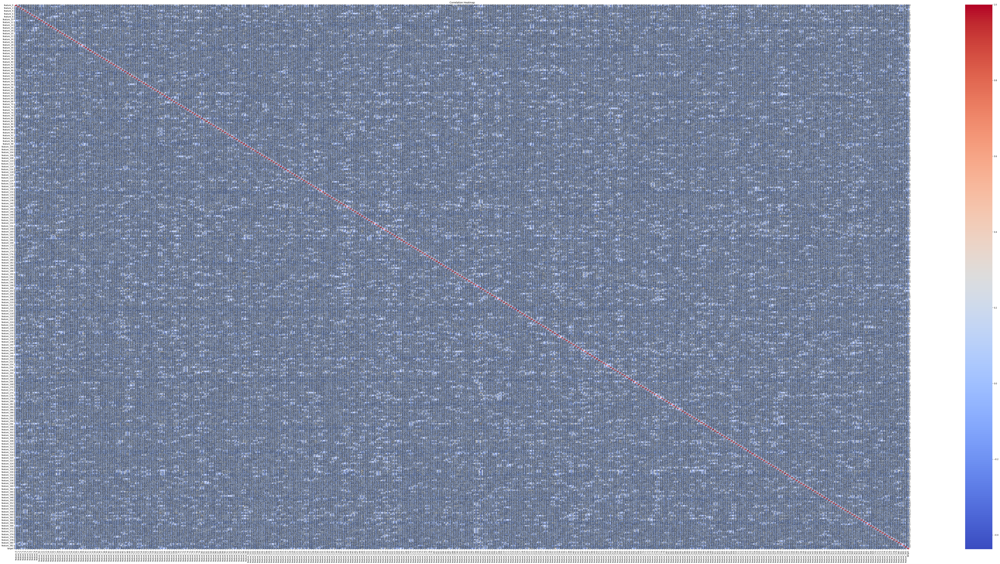

CPU times: user 9min 12s, sys: 6min 24s, total: 15min 37s
Wall time: 15min 54s


In [ ]:
%%time

plt.figure(figsize=(100,50))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

Since there are 384 features, it is difficult to represent their relation with target variable using Correlation matrix. Therefore below are histograms for all features wrt target variable. The data is distributed normally.

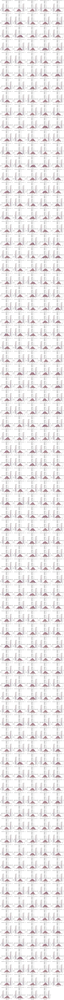

CPU times: user 24min 35s, sys: 43.5 s, total: 25min 19s
Wall time: 25min 31s


In [ ]:
%%time

target = df['target']
cols = 5
rows = (len(df.columns) - 1) // cols + 1
fig, axes = plt.subplots(rows, cols, figsize=(20, 4*rows))
axes = axes.flatten()

for i, column in enumerate(df.columns[:-1]):
    sns.histplot(df, x=column, hue=target, kde=True, fill=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {column} by {target}')
    axes[i].set_xlabel(column)
    axes[i].set_ylabel('Density')

for j in range(i + 1, rows * cols):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


---

## PCA

- Perform Principal Component Analysis (PCA) with 100 components

- Visualize the explained variance for principal components

- Perform clustering analysis with top 2 components with highest explained variance and visualize the result in scatter plot.

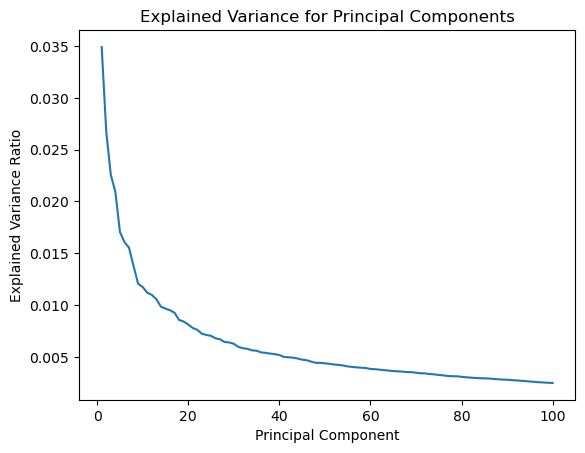

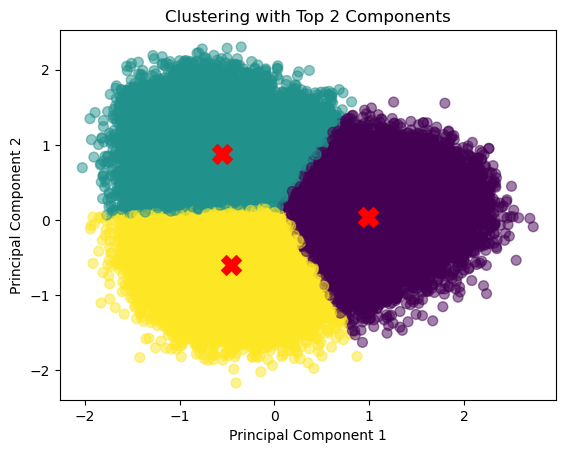

CPU times: user 10.5 s, sys: 4.91 s, total: 15.4 s
Wall time: 4.01 s


In [ ]:
%%time

df.dropna()
processed_df = df

X = processed_df.drop(columns=['target'])
y = processed_df['target']

pca = PCA(n_components=100)
X_pca = pca.fit_transform(X)

plt.plot(range(1, 101), pca.explained_variance_ratio_)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance for Principal Components')
plt.show()

top_2_components = X_pca[:, :2]

kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(top_2_components)

plt.scatter(top_2_components[:, 0], top_2_components[:, 1], c=kmeans.labels_, cmap='viridis', s=50, alpha=0.5)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', marker='*', s=200, label='Centroids')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Clustering with Top 2 Components')
plt.show()


---

## Data Pre-processing & Feature Engineering

- Perform Feature Engineering on the dataset.

In [ ]:
X = df.drop(columns=['target'])
y = df['target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

---
## Modeling

- Train at least ***three*** different classifier models (e.g., SVM, Logistic Regression, KNN, etc.) and optimize hyperparameters to enhance performance.

- Implement a validation pipeline utilizing K-fold cross-validation and your choice of dimensionality reduction technique to choose the best (Model + Number of features). For each classifier, report classification accuracy, precision, recall, and F1 score with both macro and weighted averages.


In [ ]:
%%time
# Creating pipeline for each classifier

pca = PCA(n_components=100)
X_train = pca.fit_transform(X_train_scaled)
X_test = pca.transform(X_test_scaled)

smote = SMOTE(random_state=42)
X_train, y_train = smote.fit_resample(X_train, y_train)

classifiers = {
    'SVM': SVC(),
    'Logistic Regression': LogisticRegression(),
    'KNN': KNeighborsClassifier()
}

param_grids = {
    'SVM': {'svc__C': [0.1, 1, 10], 'svc__gamma': [0.1, 0.01, 0.001], 'svc__kernel': ['rbf','sigmoid']},
    'Logistic Regression': {'logisticregression__C': [0.1, 1, 10], 'logisticregression__penalty': ['l1', 'l2']}, 'logisticregression__solver': ['lbfgs', 'saga'],
    'KNN': {'kneighborsclassifier__n_neighbors': [3, 5, 7], 'kneighborsclassifier__weights': ['uniform', 'distance']}
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for classifier_name, classifier in classifiers.items():
    print(f"Classifier: {classifier_name}")
    pipe = make_pipeline(
        classifier
    )

    grid_search = GridSearchCV(pipe, param_grids[classifier_name], cv=cv, scoring='f1_macro')
    grid_search.fit(X_train, y_train)

    print("Best parameters found:", grid_search.best_params_)
    print("Best cross-validation accuracy:", grid_search.best_score_)

    y_pred = grid_search.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    precision_macro = precision_score(y_test, y_pred, average='macro')
    recall_macro = recall_score(y_test, y_pred, average='macro')
    f1_macro = f1_score(y_test, y_pred, average='macro')
    precision_weighted = precision_score(y_test, y_pred, average='weighted')
    recall_weighted = recall_score(y_test, y_pred, average='weighted')
    f1_weighted = f1_score(y_test, y_pred, average='weighted')

    print("Test Accuracy:", accuracy)
    print("Precision (Macro):", precision_macro)
    print("Recall (Macro):", recall_macro)
    print("F1 Score (Macro):", f1_macro)
    print("Precision (Weighted):", precision_weighted)
    print("Recall (Weighted):", recall_weighted)
    print("F1 Score (Weighted):", f1_weighted)
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))



Classifier: SVM
Best parameters found: {'svc__C': 1, 'svc__gamma': 0.001, 'svc__kernel': 'rbf'}
Best cross-validation accuracy: 0.7366435185185185
Test Accuracy: 0.736574074074074
Precision (Macro): 0.7321167449268071
Recall (Macro): 0.7369724569303381
F1 Score (Macro): 0.731815216313654
Precision (Weighted): 0.7316324821049942
Recall (Weighted): 0.736574074074074
F1 Score (Weighted): 0.7313602593582161

Classification Report:
              precision    recall  f1-score   support

           1       0.63      0.57      0.60      1079
           2       0.72      0.80      0.75      1109
           3       0.74      0.85      0.79      1076
           4       0.64      0.51      0.57      1110
           5       0.85      0.90      0.87      1086
           6       0.91      0.88      0.89      1057
           7       0.65      0.50      0.57      1068
           8       0.71      0.74      0.73      1044
           9       0.73      0.81      0.77      1104
          10       0.76     

In [ ]:
# Introducing solver parameter for Logistic Regression -

pca = PCA(n_components=100)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_pca, y_train)

classifier = LogisticRegression()
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['lbfgs', 'saga']}


cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(classifier, param_grid, cv=cv, scoring='f1_macro', n_jobs=-1)
grid_search.fit(X_train_resampled, y_train_resampled)

print("Best parameters found:", grid_search.best_params_)
best_model = grid_search.best_estimator_

y_pred = best_model.predict(X_test_pca)
print(classification_report(y_test, y_pred))

/Users/aditisonawane/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/aditisonawane/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/aditisonawane/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/aditisonawane/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/aditisonawane/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/adi

Best parameters found: {'C': 1, 'penalty': 'l2', 'solver': 'lbfgs'}
              precision    recall  f1-score   support

           1       0.62      0.56      0.59      1079
           2       0.71      0.77      0.74      1109
           3       0.74      0.83      0.78      1076
           4       0.59      0.50      0.54      1110
           5       0.85      0.88      0.87      1086
           6       0.88      0.87      0.88      1057
           7       0.61      0.52      0.56      1068
           8       0.69      0.73      0.71      1044
           9       0.74      0.79      0.76      1104
          10       0.76      0.80      0.78      1067

    accuracy                           0.72     10800
   macro avg       0.72      0.72      0.72     10800
weighted avg       0.72      0.72      0.72     10800



---
## Evaluation and Reporting

- Divide the train dataset into 2 sets : Training set + Validation set

- Select the model that is expected to performs optimally on the Validation set and provide the predictions accordingly. Give clear conclusions

In [ ]:
%%time

X_train_new, X_val_new, y_train_new, y_val_new = train_test_split(X, y, test_size=0.2, random_state=42)

CPU times: user 38.8 ms, sys: 93.8 ms, total: 133 ms
Wall time: 132 ms


In [ ]:
%%time

best_params = {
    'C': 1, 'gamma': 0.001, 'kernel': 'rbf'
}

optimal = SVC(**best_params)

CPU times: user 30 µs, sys: 3 µs, total: 33 µs
Wall time: 39.8 µs


In [ ]:
%%time

optimal.fit(X_train_new,y_train_new)
val_pred = optimal.predict(X_val_new)

print(val_pred)

[ 1  1  2 ...  3  5 10]
CPU times: user 26.9 s, sys: 6.94 s, total: 33.8 s
Wall time: 4.73 s


From the modeling phase, we can observe that SVM gave the best outcomes, with an F1-score of 74%. The efficiency of algorithm involved several key factors, including data scaling, using SMOTE for data resampling, and implementation of GridSearchCV on the PCA-transformed dataset.

---
## External Evaluation

- A dataset named ‘test.csv’ is provided to you which has 6000 vector embeddings. You have to choose the best model(the model which has the highest score) and then use that model to predict the label on the ‘test.csv’.

In [ ]:
test_data = pd.read_pickle('/Users/dhanushchandra/Desktop/final/Problem3/data/test.pkl', compression = 'gzip')


In [ ]:
%%time

test_data.isna().sum().sum()

CPU times: user 12.6 ms, sys: 2.97 ms, total: 15.6 ms
Wall time: 35 ms


0

In [ ]:
test_data.head

<bound method NDFrame.head of        feature_0  feature_1  feature_2  feature_3  feature_4  feature_5  \
10327  -0.384187  -0.340292  -0.208568  -0.098588   0.080812  -0.015953   
11901  -0.730941   0.012670   0.040059  -0.769873   0.197866   0.468066   
13305  -0.564719  -0.195337   0.668075   0.078224  -0.009486   0.307535   
27477  -0.219835  -0.236748   0.361487   0.096452  -0.007290   0.152291   
55627   0.016768  -0.430905   0.180677  -0.001549  -0.339347   0.219998   
...          ...        ...        ...        ...        ...        ...   
15850  -0.007369   0.213219   0.408932  -0.522408  -0.007985  -0.056556   
3796   -0.096542  -0.031756   0.230841  -0.559349   0.153018  -0.103181   
8165   -0.319242   0.478008   0.293586  -0.206318   0.111456   0.222070   
24486  -0.393684  -0.154940   0.313906  -0.187108   0.077095  -0.113135   
59546  -0.115124   0.160738   0.304710  -0.336392   0.163524   0.049360   

       feature_6  feature_7  feature_8  feature_9  ...  feature_374  

In [ ]:
test_data_scaled = scaler.transform(test_data)
test_data_pca = pca.transform(test_data_scaled)
test_pred = optimal.predict(test_data_pca)


In [ ]:
test_pred

array([ 7, 10,  2, ..., 10,  7,  3])

In [ ]:
submission_df = pd.DataFrame(test_pred, columns=['prediction'])
submission_df

,prediction
0,7
1,10
2,2
3,1
4,5
...,...
5995,9
5996,2
5997,10
5998,7


In [ ]:
submission_df.to_csv('/Users/dhanushchandra/Desktop/final/Problem3/data/submission.csv', index=False)